In [1]:
# 중력방향 정렬
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation

# GLB 로드
scene = trimesh.load('/data/ephemeral/home/project/output/scene.glb')

# ARCore 중력 방향 → GLB 계산
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

# Z+ 방향으로 회전
R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 렌더링 확인
# 축 길이 설정
axis_length = 1

# 원점 (0, 0, 0) 사용
origin = np.array([0, 0, 0])

# 원점 (0, 0, 0)에 포인트 생성
# 방법 1: 작은 구(sphere) 사용
origin_point = trimesh.creation.icosphere(radius=0.02)  # 반지름 0.01
origin_point.apply_translation([0, 0, 0])  # 원점으로 이동
origin_point.visual.face_colors = [255, 255, 0, 255]  # 노란색


# X축 (빨강)
x_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
x_line.apply_transform(trimesh.transformations.rotation_matrix(
    np.pi/2, [0, 1, 0], [0, 0, 0]
))
x_line.apply_translation(origin + [axis_length/2, 0, 0])  # 원점 기준
x_line.visual.face_colors = [255, 0, 0, 255]

# Y축 (초록)
y_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
y_line.apply_transform(trimesh.transformations.rotation_matrix(
    -np.pi/2, [1, 0, 0], [0, 0, 0]
))
y_line.apply_translation(origin + [0, axis_length/2, 0])  # 원점 기준
y_line.visual.face_colors = [0, 255, 0, 255]

# Z축 (파랑)
z_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
z_line.apply_translation(origin + [0, 0, axis_length/2])  # 원점 기준
z_line.visual.face_colors = [0, 0, 255, 255]

# 씬에 추가
scene.add_geometry([x_line, y_line, z_line,origin_point])
scene.show()

In [ ]:
# Visualization function


import matplotlib.pyplot as plt

def visualize_volume_3d(volume_data, center_axis, z_min=None, z_max=None):
    """3D visualization of volume calculation result"""
    if not volume_data:
        print("No volume data to visualize")
        return
    
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Sort by height
    sorted_data = sorted(volume_data, key=lambda x: x['z'])
    
    # Draw circles at each height
    for data in sorted_data:
        z = data['z']
        radius = data['radius']
        
        theta = np.linspace(0, 2*np.pi, 50)
        x = center_axis[0] + radius * np.cos(theta)
        y = center_axis[1] + radius * np.sin(theta)
        z_circle = np.full_like(theta, z)
        
        ax.plot(x, y, z_circle, 'b-', linewidth=1.5, alpha=0.7)
    
    # Draw center axis
    if sorted_data:
        z_min_actual = sorted_data[0]['z']
        z_max_actual = sorted_data[-1]['z']
        
        z_axis_min = z_min if z_min is not None else z_min_actual
        z_axis_max = z_max if z_max is not None else z_max_actual
        
        ax.plot([center_axis[0], center_axis[0]], 
                [center_axis[1], center_axis[1]], 
                [z_axis_min, z_axis_max], 'g-', linewidth=3, label='Center Axis')
    
    # Calculate ranges for equal aspect ratio
    max_radius = max([d['radius'] for d in sorted_data])
    z_min_actual = sorted_data[0]['z']
    z_max_actual = sorted_data[-1]['z']
    
    x_range = max_radius * 2
    y_range = max_radius * 2
    z_range = z_max_actual - z_min_actual
    
    max_range = max(x_range, y_range, z_range)
    
    # Set equal aspect ratio
    ax.set_xlim(center_axis[0] - max_range/2, center_axis[0] + max_range/2)
    ax.set_ylim(center_axis[1] - max_range/2, center_axis[1] + max_range/2)
    ax.set_zlim((z_min_actual + z_max_actual)/2 - max_range/2, 
                (z_min_actual + z_max_actual)/2 + max_range/2)
    
    # Set equal aspect (matplotlib 3.3.0+)
    try:
        ax.set_box_aspect([1, 1, 1])  # Equal aspect ratio
    except AttributeError:
        pass  # Older matplotlib versions
    
    # Calculate total volume
    total_volume = sum((sorted_data[i]['area'] + sorted_data[i+1]['area']) / 2 * 
                      (sorted_data[i+1]['z'] - sorted_data[i]['z']) 
                      for i in range(len(sorted_data) - 1))
    
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    ax.set_zlabel('Z (m)')
    ax.set_title(f'3D Volume Visualization\n'
                f'Total Volume: {total_volume * 1000:.2f} mL ({total_volume * 1e6:.2f} cm³)')
    ax.legend()
    plt.tight_layout()
    plt.show()



def visualize_detect_circle_at_axis(points, z, center_axis, threshold=0.0003):
    """Visualize detect_circle_at_axis result for a given height"""
    # Extract slice
    slice_points = get_slice(points, z)
    if len(slice_points) < MIN_POINTS_PER_SLICE:
        print(f"Insufficient points at height {z:.4f}m ({len(slice_points)} points)")
        return
    
    slice_2d = slice_points[:, :2]
    
    # Detect circle
    radius = detect_circle_at_axis(slice_2d, center_axis, threshold=threshold)
    
    # Visualization
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    
    # Calculate distances from center axis
    distances = np.linalg.norm(slice_2d - center_axis, axis=1)
    
    if radius:
        # Separate inliers/outliers
        inliers = np.abs(distances - radius) < threshold
        
        # Inliers (red)
        ax.scatter(slice_2d[inliers, 0], slice_2d[inliers, 1], 
                  c='red', s=20, alpha=0.7, label=f'Inliers ({np.sum(inliers)})')
        
        # Outliers (gray)
        ax.scatter(slice_2d[~inliers, 0], slice_2d[~inliers, 1], 
                  c='lightgray', s=5, alpha=0.3, label='Outliers')
        
        # Draw detected circle
        theta = np.linspace(0, 2*np.pi, 100)
        circle_x = center_axis[0] + radius * np.cos(theta)
        circle_y = center_axis[1] + radius * np.sin(theta)
        ax.plot(circle_x, circle_y, 'b-', linewidth=2, label=f'Circle (r={radius:.4f}m)')
        
        # Calculate point density
        circumference = 2 * np.pi * radius
        ppm = np.sum(inliers) / circumference if circumference > 0 else 0
        
        ax.set_title(f'Height {z:.4f}m - Circle Detected\nRadius: {radius:.4f}m, Density: {ppm:.1f} points/m')
    else:
        # Circle detection failed
        ax.scatter(slice_2d[:, 0], slice_2d[:, 1], c='gray', s=10, alpha=0.5)
        ax.set_title(f'Height {z:.4f}m - Circle Detection Failed')
    
    # Mark center axis
    ax.plot(center_axis[0], center_axis[1], 'go', markersize=10, 
           label=f'Center Axis ({center_axis[0]:.4f}, {center_axis[1]:.4f})')
    
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    ax.legend()
    ax.grid(True, alpha=0.3)
    ax.set_aspect('equal')
    plt.tight_layout()
    plt.show()

def visualize_radius_vs_height(volume_data, figsize=(10, 8)):
    """높이와 반지름의 관계를 2D 그래프로 시각화"""
    if not volume_data:
        print("No volume data to visualize")
        return
    
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.ticker import MultipleLocator
    
    # 높이 순으로 정렬
    sorted_data = sorted(volume_data, key=lambda x: x['z'])
    
    # 데이터 추출
    heights = [data['z'] for data in sorted_data]
    radii = [data['radius'] for data in sorted_data]
    areas = [data['area'] for data in sorted_data]
    
    # 그래프 생성
    fig, axes = plt.subplots(2, 1, figsize=figsize, sharex=True)
    
    # 1. 반지름 vs 높이
    ax1 = axes[0]
    ax1.plot(radii, heights, 'b-o', linewidth=1, markersize=4, label='Radius')
    ax1.fill_betweenx(heights, 0, radii, alpha=0.3, color='blue', label='Cross-section')
    ax1.set_xlabel('Radius (m)', fontsize=12)
    ax1.set_ylabel('Height (m)', fontsize=12)
    ax1.set_title('Radius vs Height', fontsize=14, fontweight='bold')
    ax1.grid(True, alpha=0.3)
    ax1.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
    ax1.invert_yaxis()  # 높이가 아래에서 위로 증가하도록 (일반적인 좌표계)
    
    # x축과 y축 스케일 맞추기
    ax1.set_aspect('equal', adjustable='box')
    
    # 5mm (0.005m) 단위로 tick 설정 (minor ticks로 설정하고 일부만 표시)
    tick_interval = 0.005  # 5mm
    ax1.xaxis.set_minor_locator(MultipleLocator(tick_interval))
    ax1.yaxis.set_minor_locator(MultipleLocator(tick_interval))
    
    # Major ticks는 10mm (0.01m) 간격으로 설정하여 라벨이 너무 촘촘하지 않게
    ax1.xaxis.set_major_locator(MultipleLocator(0.01))
    ax1.yaxis.set_major_locator(MultipleLocator(0.01))
    
    # 통계 정보 추가 (왼쪽 밖으로 많이 이동)
    if heights:
        height_range = heights[-1] - heights[0]
        avg_radius = np.mean(radii)
        max_radius = np.max(radii)
        min_radius = np.min(radii)
        
        info_text = (f'Height range: {height_range:.4f} m\n'
                    f'Avg radius: {avg_radius:.4f} m\n'
                    f'Min radius: {min_radius:.4f} m\n'
                    f'Max radius: {max_radius:.4f} m')
        # 왼쪽 밖으로 많이 이동 (x=-0.3으로 설정)
        ax1.text(-5, 0.98, info_text, transform=ax1.transAxes,
                verticalalignment='top', horizontalalignment='left',
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5), 
                fontsize=9)
    
    # 2. 단면적 vs 높이
    ax2 = axes[1]
    ax2.plot(areas, heights, 'r-o', linewidth=2, markersize=4, label='Cross-sectional Area')
    ax2.fill_betweenx(heights, 0, areas, alpha=0.3, color='red')
    ax2.set_xlabel('Cross-sectional Area (m²)', fontsize=12)
    ax2.set_ylabel('Height (m)', fontsize=12)
    ax2.set_title('Cross-sectional Area vs Height', fontsize=14, fontweight='bold')
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.invert_yaxis()
    
    # 부피 계산 및 표시
    if len(sorted_data) > 1:
        total_volume = sum((sorted_data[i]['area'] + sorted_data[i+1]['area']) / 2 * 
                          (sorted_data[i+1]['z'] - sorted_data[i]['z']) 
                          for i in range(len(sorted_data) - 1))
        
        fig.suptitle(f'Volume Analysis\n'
                    f'Total Volume: {total_volume * 1000:.2f} mL ({total_volume * 1e6:.2f} cm³) | '
                    f'Data points: {len(sorted_data)}', 
                    fontsize=14, fontweight='bold', y=0.995)
    
    plt.tight_layout()
    plt.show()


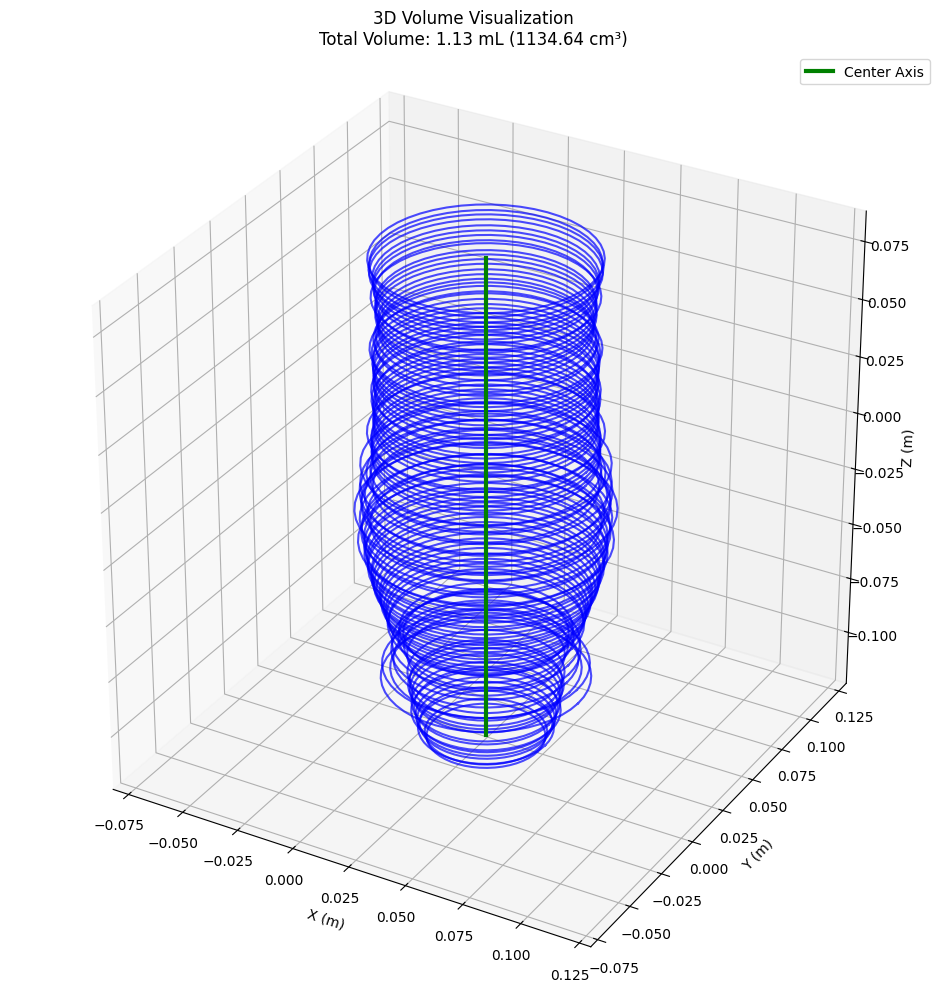

In [ ]:
visualize_volume_3d(volume_data, center_axis)

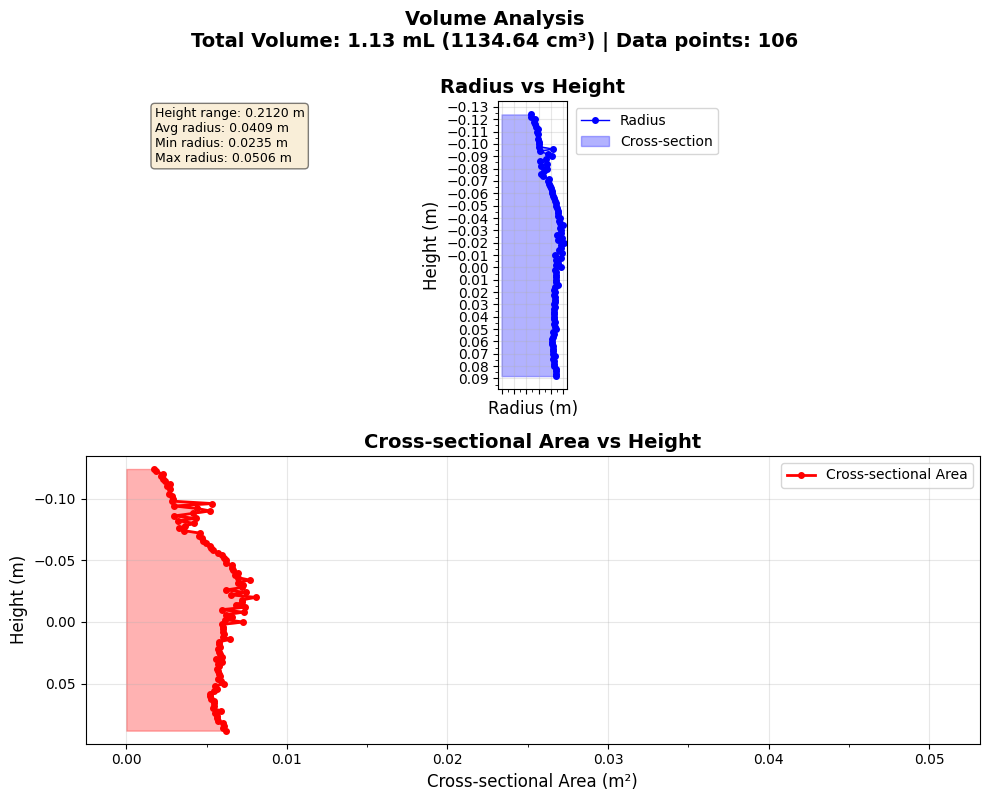

In [ ]:
visualize_radius_vs_height(volume_data)

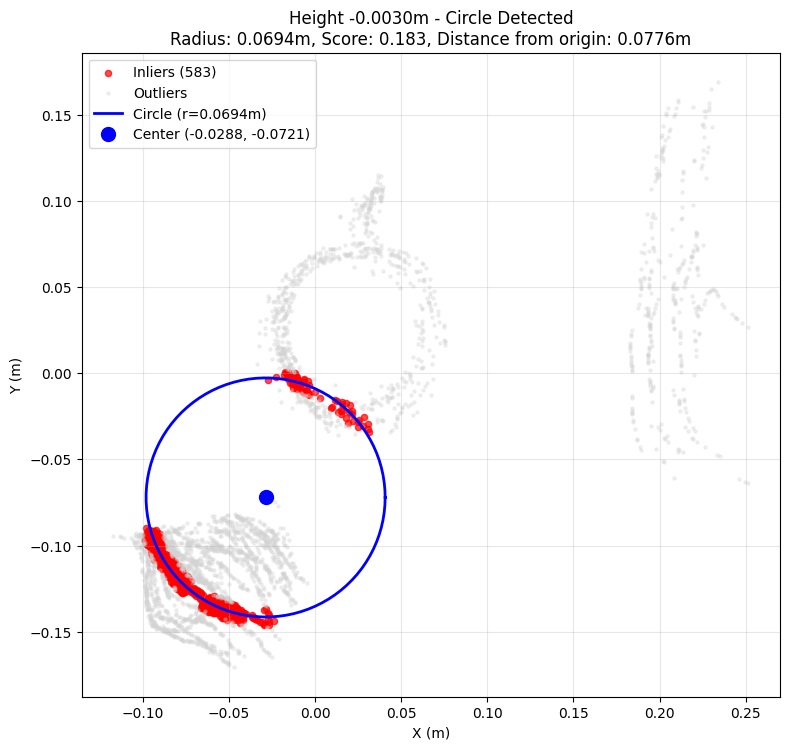

In [ ]:
visualize_fit_circle_ransac(points, -0.003)  # Visualize at height 0.05m

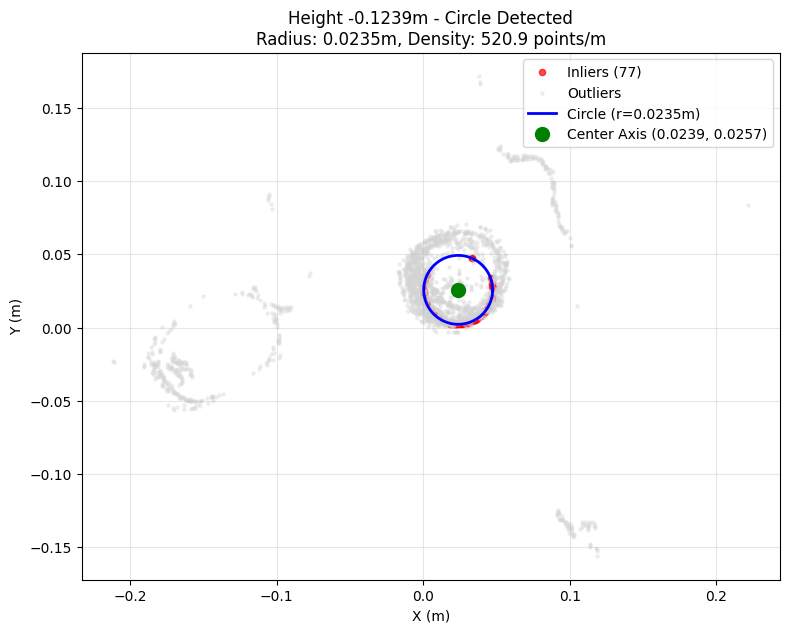

In [ ]:
visualize_detect_circle_at_axis(points,-0.1239, center_axis)